In [1]:
%matplotlib inline
import matplotlib
matplotlib.rc('font', family='arial') 
import matplotlib.pyplot as plt
from matplotlib.cm import gray, inferno, magma, viridis

import numpy as np
import flika as flk

from functools import partial
import shutil
from skimage.exposure import rescale_intensity as rescale
from skimage.transform import downscale_local_mean as downscale
from fish.image.alignment import estimate_translation
from moviepy.editor import ImageSequenceClip, VideoClip, concatenate_videoclips
from moviepy.video.io.bindings import mplfig_to_npimage
from scipy.ndimage import median_filter
from fish.image.zds import ZDS
from scipy.interpolate import interp1d
from dask.distributed import Client
from fish.util.distributed import get_jobqueue_cluster
from dask.array import coarsen
import dask.array as da
from pathlib import Path
import os
from fish.util.plot import apply_cmap
from matplotlib.patches import Rectangle
flk.start_flika()

Starting flika


Starting flika inside IPython


In [2]:
def shift_yx(im, shifts, block_id):
    from scipy.ndimage.interpolation import shift
    t = block_id[0]    
    return shift(im.astype('float32'), (0,0, *shifts[t]), order=1, cval=100)

def reg(fixed, moving):
    from fish.image.alignment import estimate_translation    
    from numpy import expand_dims
    affs =  estimate_translation(fixed.squeeze(), moving.squeeze()).affine
    return expand_dims(affs, 0)

20171107_1_3_gfaprgeco_gfaptrpv1_6dpf_csn_20171107_113628 :: deep (z 0 : 5) , t 4771, t 4846, 5063
20171022_1_3_GFAPrgeco_injectedTRPV1_6dpf_beforeaftercsn10uM_20171022_141052 :: giving-up triggered events are global, hard to define initiation zone
20171022_4_3_GFAPrgeco_injectedTRPV1_6dpf_bathesystemwater_bathecsn5uM :: great moment around 6230

In [3]:
base_dirs = ('/nrs/ahrens/Yu/SPIM/active_dataset/TRPV1/20171107/fish1/20171107_1_1_gfaprgeco_gfaptrpv1_6dpf_red_20171107_111816/',
           '/nrs/ahrens/Yu/SPIM/active_dataset/TRPV1/20171022/fish1/20171022_1_3_GFAPrgeco_injectedTRPV1_6dpf_beforeaftercsn10uM_20171022_141052/',
            '/nrs/ahrens/Yu/SPIM/active_dataset/TRPV1/20171107/fish2/20171107_2_3_gfaprgeco_gfaptrpv1_6dpf_csn_20171107_135106/',
            '/nrs/ahrens/Yu/SPIM/active_dataset/TRPV1/20171022/fish4/20171022_4_3_GFAPrgeco_injectedTRPV1_6dpf_bathesystemwater_bathecsn5uM_20171022_230815/')

In [4]:
base_dir = base_dirs[-1] 
dset = ZDS(base_dir + 'raw/')
fs_im = dset.metadata['volume_rate']

data = dset.data
exp_name = dset.metadata['data_header'] 
reg_path = base_dir + 'regparams_affine.npy'

medfilt = partial(median_filter, size=(1,1,5,5))
data_filt = data.astype('float32').map_blocks(medfilt, dtype='float32')    
anat_ref = data_filt[data_filt.shape[0]//2 + np.arange(-5,5)].mean(0).compute(scheduler='threads')

try: 
    shifts = -np.load(reg_path)[:,:-1,-1]
except FileNotFoundError:
    shifts = None    
    print('No valid regparams found. They will be estimated')
data.shape

(13501, 22, 744, 960)

In [5]:
def mydff(v, fs_im):
    from fish.image.vol import dff
    camera_offset = 100
    window = 300 * fs_im
    percentile = 20
    offset = 10    
    downsample = 10;
    return dff((v - camera_offset).clip(1, None), window, percentile, offset, downsample, axis=0).astype('float32')

In [6]:
cluster = get_jobqueue_cluster()
client = Client(cluster)
client

Client Scheduler: tcp://10.36.60.32:35130 Dashboard: http://10.36.60.32:8787/status,Cluster Workers: 0 Cores: 0 Memory: 0 B


In [10]:
# plot the whole-brain mean vs time to figure out when csn was added

In [11]:
cluster.start_workers(30)
mn = data.mean((1,2,3)).compute()
cluster.stop_all_jobs()

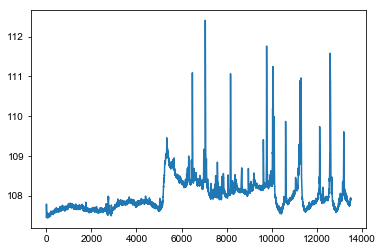

In [12]:
plt.plot(mn)

In [7]:
rois = ((slice(2000, 2420), slice(0,None), slice(None), slice(None)),
        (slice(9500, 9920), slice(0,None), slice(None), slice(None)))

In [17]:
results = []
cluster.start_workers(200)
for roi in rois:        
    data_tx = data[roi].map_blocks(shift_yx, shifts[roi[0]], dtype='float32')
    data_filt = data_tx.map_blocks(lambda v: median_filter(v, size=(1,1,3,3)))
    ds_xy = 2
    data_ds = coarsen(np.mean, data_filt, {2: ds_xy, 3: ds_xy})
    rechunked = data_ds.rechunk(chunks=(-1, -1, 'auto','auto'))
    data_dff = rechunked.map_blocks(lambda v: mydff(v, fs_im), dtype='float32').max(1)
    results.append(data_dff.compute())

cluster.stop_all_jobs()

In [8]:
result_names = ('pre','post')
out_path = '/groups/ahrens/ahrenslab/projects/ngm/'
out_fnames = [exp_name + f'_{r}.tif' for r in result_names]

In [29]:
from skimage.io import imsave
[imsave(out_path + out_fname, results[ind], imagej=True) for ind, out_fname in enumerate(out_fnames)]

[None, None]

In [9]:
from skimage.io import imread
results = [imread(out_path + fn) for fn in out_fnames]

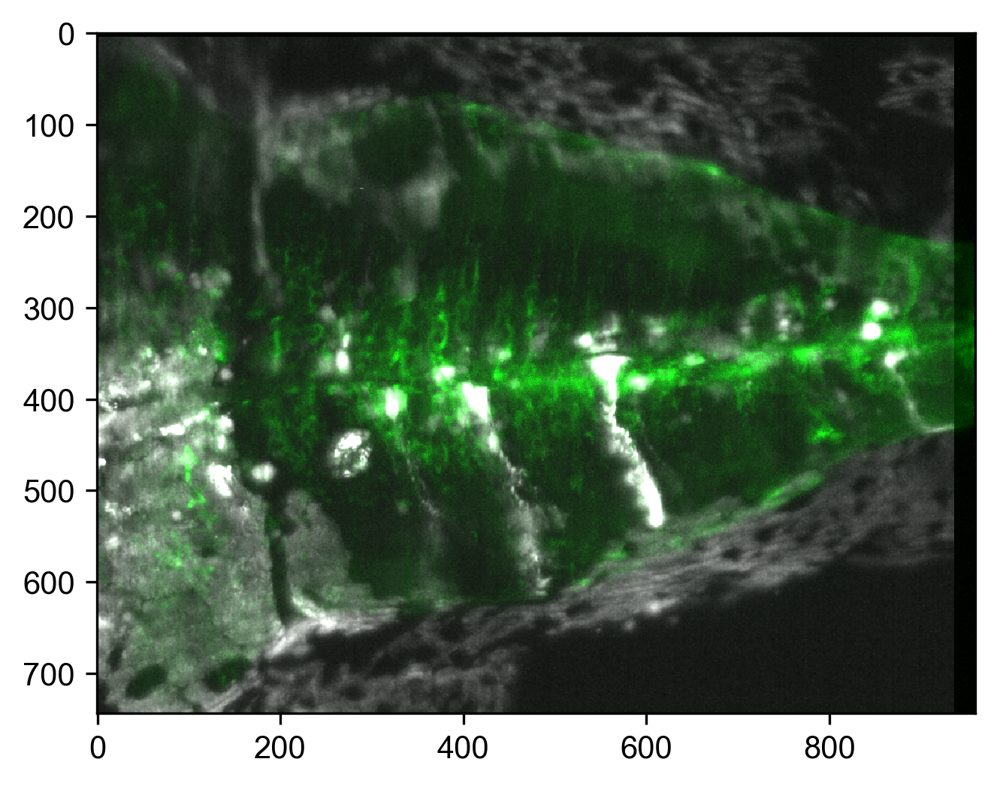

In [10]:
from skimage.io import imread
try:
    dset_g = ZDS(str(next(Path(base_dir).parent.glob('*GREEN*'))) + os.path.sep)
    dset_r = ZDS(str(next(Path(base_dir).parent.glob('*RED*'))) + os.path.sep)
    anat_g = dset_g.data.mean(0).compute(scheduler='threads')
    anat_r = dset_r.data.mean(0).compute(scheduler='threads')    
except StopIteration:
    dset_g = ZDS(str(next(Path(base_dir).parent.glob('*green*'))) + os.path.sep)
    dset_r = ZDS(str(next(Path(base_dir).parent.glob('*red*'))) + os.path.sep)
    anat_g = dset_g.data.mean(0).compute(scheduler='threads')
    anat_r = dset_r.data.mean(0).compute(scheduler='threads')
except StopIteration:
    anat_g = imread(str(next(Path(base_dir).parent.glob('*TRPV1*'))))
    anat_r = imread(str(next(Path(base_dir).parent.glob('*RGECO*'))))
    dset_r = []
    dset_g = []

    
expn = dset.metadata['data_header']
sample = dset.data[-1].compute(scheduler='threads')

fig, axs = plt.subplots(dpi=300)

tx = estimate_translation(sample.max(0), anat_r.max(0))
r_tx= gray(rescale(tx.transform(anat_r.max(0)),in_range=(100,200), out_range=(0,1))) * np.array([1,1,1,.5])
g_tx = gray(rescale(tx.transform(anat_g.max(0)), in_range=(100,200), out_range=(0,1))) * np.array([1,1,1,1])
tmp = gray(rescale(sample.max(0).astype('float32'),in_range=(100,450), out_range=(0,1))) * np.array([0,1,0,1])
axs.imshow((g_tx + tmp).clip(0,1))

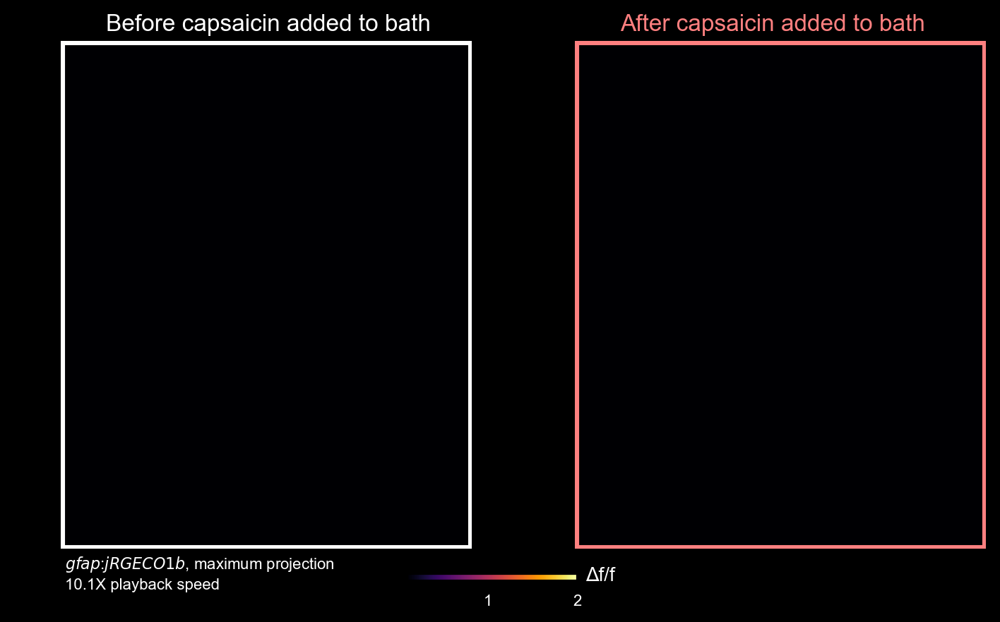

In [11]:
in_range_dff = (.1,2)
data_dur = 30
data_playback_scale = (results[0].shape[0] / fs_im) / data_dur
fps = 30
figsize = (8, 4.5)

crop = slice(None), slice(None), slice(10,-10)
dff_ = results[0][crop], results[1][crop]
ims_interp = [interp1d(np.linspace(0, data_dur, r.shape[0]), r, axis=0, fill_value='extrapolate') for r in dff_]

anat_rgeco = downscale(anat_ref[crop[0]], (1,2,2))[:,crop[1], crop[2]].max(0)
anat_rgeco_rgb = gray(rescale(anat_rgeco, in_range=(100,300), out_range=(0,1))) * np.array([.25,.25,.25,1])

fig_dff, axs_dff = plt.subplots(dpi=200, figsize=figsize, ncols=2)

fig_dff.set_facecolor('k')
rect_colors = ['w', (1,.5,.5)]
for ind_ax, ax in enumerate(axs_dff):
    ax.set_facecolor('k')
    ax.axis('off')
    ax.imshow(np.zeros(dff_[0][0].shape[::-1]), clim=in_range_dff, cmap='inferno')
    ax.add_patch(Rectangle((0,0), 1,1, transform=ax.transAxes, fill=False, linewidth=4, color=rect_colors[ind_ax]))

axs_dff[0].set_position([.05,.1,.45,.8])
axs_dff[1].set_position([.505,.1,.45,.8])

axs_cbar = fig_dff.add_axes([.4, .05, .15, .01])
cbar = plt.colorbar(axs_dff[0].images[0], cax=axs_cbar, orientation='horizontal')
axs_cbar.text(1.05, 0, '\u0394f/f', transform=axs_cbar.transAxes, fontdict={'fontsize' : 10, 'color' : 'w'})
axs_cbar.tick_params(labelcolor='w', labelsize=8)
axs_cbar.set_xticks([0,1])
fd_small = {'fontsize' : 8, 'color' : 'w'}

#trp_label = dict(x = .01, y=-.1, s='$\it{gfap}$:TRPV1-T2A-GFP', transform=axs.transAxes, fontdict=dict(color='y', size=8))
condition_labels = (dict(x=.11, y = 1.02, s='Before capsaicin added to bath', transform=axs_dff[0].transAxes, fontdict={'fontsize' : 12, 'color' : rect_colors[0]}),
                    dict(x=.11, y = 1.02, s='After capsaicin added to bath', transform=axs_dff[1].transAxes, fontdict={'fontsize' : 12, 'color' : rect_colors[1]}))
rgeco_label = dict(x = .01, y=-.04, s='$\it{gfap}$:$\it{jRGECO1b}$, maximum projection', transform=axs_dff[0].transAxes, fontdict=dict(color='w', size=8))
timing_label = dict(x = .01, y =-.08, s=f'{data_playback_scale:.1f}X playback speed',transform=axs_dff[0].transAxes, fontdict=dict(color='w', size=8))

#axs.text(**trp_label)
axs_dff[0].text(**condition_labels[0])
axs_dff[1].text(**condition_labels[1])
axs_dff[0].text(**rgeco_label)
axs_dff[0].text(**timing_label)

def draw_frame(t_):
    for ind_im, d in enumerate(dff_):
        #chunk_rgb = inferno(rescale(ims_interp[ind_im](ind_s),in_range=in_range_dff, out_range=(0,1)))    
        #chunk_rgb = inferno(rescale(dff_[ind_im][ind],in_range=in_range_dff, out_range=(0,1)))    
        chunk_rgb = apply_cmap(ims_interp[ind_im](t_), 'inferno', clim=in_range_dff)
        composite = (anat_rgeco_rgb + chunk_rgb).transpose(1,0,2)
        if len(axs_dff[ind_im].images) == 0:
            axs_dff[ind_im].imshow(composite)
        else:
            axs_dff[ind_im].images[0].set_data(composite)
    return mplfig_to_npimage(fig_dff)

(-0.5, 1599.5, 899.5, -0.5)

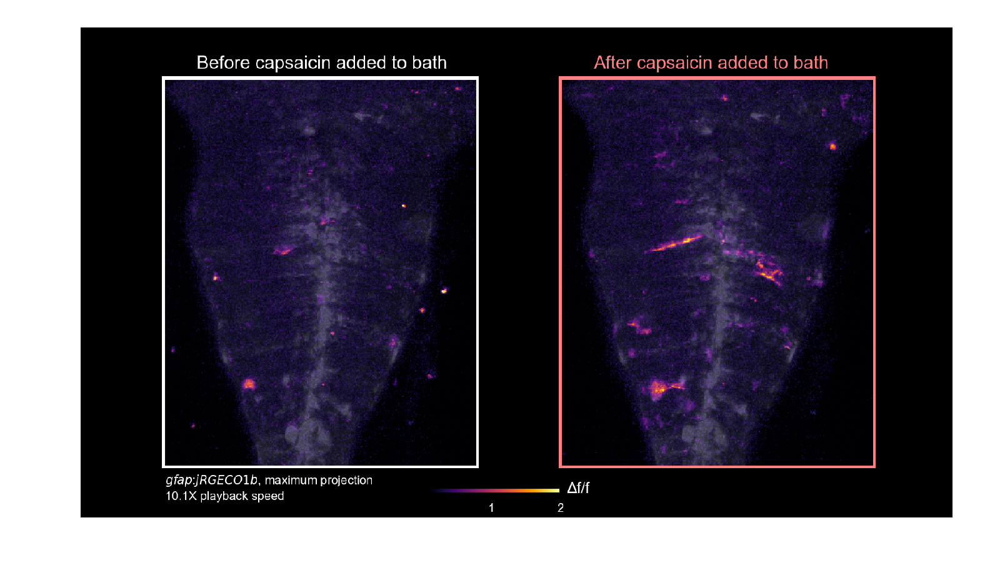

In [12]:
fig, axs_ = plt.subplots(dpi=300)
plt.imshow(draw_frame(0))
axs_.axis('off')

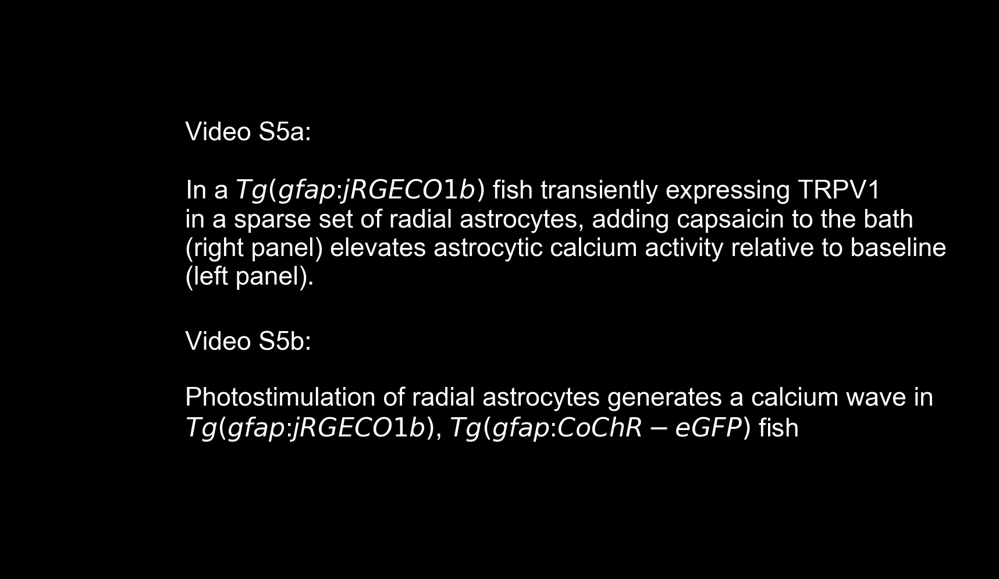

In [13]:
## make the title card 
title_dur = 4
fig_intro = plt.figure(dpi=200, figsize=figsize, facecolor='k')
ax_intro = fig_intro.add_axes((0,0,1,1))
ax_intro.set_facecolor('k')
s5a_intro_text ='''Video S5a:
                                
In a $\it{Tg(gfap}$:$\it{jRGECO1b)}$ fish transiently expressing TRPV1 
in a sparse set of radial astrocytes, adding capsaicin to the bath
(right panel) elevates astrocytic calcium activity relative to baseline 
(left panel).            
'''

s5b_intro_text = '''Video S5b:

Photostimulation of radial astrocytes generates a calcium wave in
$\it{Tg(gfap}$:$\it{jRGECO1b)}$, $\it{Tg(gfap}$:$\it{CoChR-eGFP)}$ fish                       
'''

color_fade = interp1d([0,1,2,3], [1,.75,.5,.5], fill_value='extrapolate')

s5a_intro = ax_intro.text(.15,
              .8,
              s5a_intro_text, 
              fontdict=dict(color='w', size=16), 
              transform=ax_intro.transAxes, 
              ha = 'left',
              va='top',
              multialignment='left')

s5b_intro = ax_intro.text(.15,
              .4,
              s5b_intro_text, 
              fontdict=dict(color='w', size=16), 
              transform=ax_intro.transAxes, 
              ha = 'left',
              va='top',
              multialignment='left')

def drawf_intro(t_):
    s5b_intro.set_color(3 * [0 + color_fade(t_)])
    return mplfig_to_npimage(fig_intro)

title_clip = VideoClip(drawf_intro, duration=title_dur)

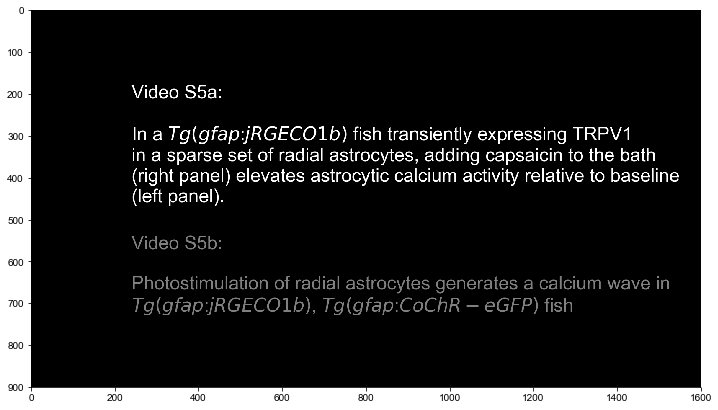

In [14]:
_,_  = plt.subplots(figsize=(12,12))
plt.imshow(drawf_intro(3))

In [15]:
data_clip = VideoClip(draw_frame, duration=data_dur)

codec = 'h264'
vid_fname = f'/nrs/ahrens/davis/tmp/{exp_name}_t{rois[0][0].start}t{rois[0][0].stop}_t{rois[1][0].start}t{rois[1][0].stop}.mp4'

composite_clip = concatenate_videoclips([title_clip, data_clip])
composite_clip.write_videofile(vid_fname, audio=False, codec=codec, fps=fps, ffmpeg_params=['-pix_fmt', 'yuv420p'])
shutil.copyfile(vid_fname, '/groups/ahrens/ahrenslab/projects/ngm/presentation/movies/Video_S5a.mp4')

t:   0%|          | 3/1020 [00:00<00:51, 19.69it/s, now=None]

Moviepy - Building video /nrs/ahrens/davis/tmp/20171022_4_3_GFAPrgeco_injectedTRPV1_6dpf_bathesystemwater_bathecsn5uM_t2000t2420_t9500t9920.mp4.
Moviepy - Writing video /nrs/ahrens/davis/tmp/20171022_4_3_GFAPrgeco_injectedTRPV1_6dpf_bathesystemwater_bathecsn5uM_t2000t2420_t9500t9920.mp4



Moviepy - Done !
Moviepy - video ready /nrs/ahrens/davis/tmp/20171022_4_3_GFAPrgeco_injectedTRPV1_6dpf_bathesystemwater_bathecsn5uM_t2000t2420_t9500t9920.mp4


'/groups/ahrens/ahrenslab/projects/ngm/presentation/movies/Video_S5a.mp4'

In [28]:
from moviepy.editor import VideoFileClip
VideoFileClip(vid_fname).ipython_display()




                                                             




t:   0%|          | 2/1020 [21:23<00:53, 18.94it/s, now=None]


t:   0%|          | 2/1020 [12:29<00:56, 18.02it/s, now=None]


                                                             




t:   0%|          | 2/1020 [21:23<00:53, 18.94it/s, now=None]


t:   0%|          | 2/1020 [12:29<00:56, 18.02it/s, now=None]



t:   0%|          | 0/1020 [00:00<?, ?it/s, now=None]

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4







t:   1%|          | 8/1020 [00:00<00:13, 77.10it/s, now=None]



t:   2%|▏         | 18/1020 [00:00<00:12, 81.64it/s, now=None]



t:   3%|▎         | 29/1020 [00:00<00:11, 88.23it/s, now=None]



t:   4%|▍         | 41/1020 [00:00<00:10, 94.16it/s, now=None]



t:   5%|▌         | 53/1020 [00:00<00:09, 98.86it/s, now=None]



t:   6%|▋         | 65/1020 [00:00<00:09, 102.19it/s, now=None]



t:   8%|▊         | 77/1020 [00:00<00:08, 105.04it/s, now=None]



t:   9%|▊         | 89/1020 [00:00<00:08, 106.94it/s, now=None]



t:  10%|▉         | 101/1020 [00:00<00:08, 108.17it/s, now=None]



t:  11%|█         | 113/1020 [00:01<00:08, 108.94it/s, now=None]



t:  12%|█▏        | 125/1020 [00:01<00:08, 109.77it/s, now=None]



t:  13%|█▎        | 137/1020 [00:01<00:07, 110.59it/s, now=None]



t:  15%|█▍        | 149/1020 [00:01<00:07, 110.64it/s, now=None]



t:  16%|█▌        | 161/1020 [00:01<00:07, 110.72it/s, now=None]



t:  17%|█▋        | 173/1020 [00:01<00:07, 110.77it/s, now

Moviepy - Done !
Moviepy - video ready __temp__.mp4
